# Look at the changes in the `ap_verify` output between two weeks

During the 5/4/2020 ap pipe meeting, we noted that the "number of DIAsources dropped sharply in one CCD, went up in others"

The hypothesis was that the decorrelation afterburner that was merged last week may have cleaned up some spurious sources, and possibly lowered the detection threshold so that more "good" sources were detected.

We want to look at the results of `ap_verify` in more detail, using code fom before the merge and immediately after.
For this analysis, the "old" code used weekly tag w.2020.17 and the new code used weekly tag w.2020.18 .
This was also the week when our conda environment was updated, removing ~50 packages from the standard install, so we want to make sure that the changes appear to be driven by the decorrelation afterburner merge.

In [1]:
%matplotlib notebook

import sys
import numpy as np
import matplotlib.pyplot as plt
import importlib

import lsst.daf.persistence as dafPersist

In [2]:
from astropy.visualization import ZScaleInterval, SqrtStretch, ImageNormalize

In [3]:
sys.path.append('/project/mrawls/ap_pipe-notebooks/')
import diaObjectAnalysis as doa
import apdbPlots as pla

### Load the data from the two runs of `ap_verify`

In [4]:
old_repo = '/project/sullivan/tickets/DM-24730/OLD/ap_verify/CI-HiTS2015/'
new_repo = '/project/sullivan/tickets/DM-24730/NEW/ap_verify/CI-HiTS2015/'

In [5]:
butler_old = dafPersist.Butler(old_repo + "output")

In [6]:
butler_new = dafPersist.Butler(new_repo + "output")

## The test data consists of two CCDs with one visit, and two CCDs with two visits

In [7]:
visits_a = [411371]
visits_b = [411420, 419802]

In [8]:
ccds_a = [56, 60]
ccds_b = [5, 10]

In [29]:
def show_image(butler, butler2=None, visit=411371, ccd=56, title=None, norm=None):
    fig, ax = plt.subplots(figsize=(7, 10))
    ax = plt.subplot(1,1,1)
    image1 = butler.get("deepDiff_differenceExp", dataId={"visit":visit, "ccdnum":ccd})
    img_use = image1.image.array
    if title is None:
        title = ''
    title += f"Visit {visit} CCD {ccd}"
    if butler2 is not None:
        image2 = butler2.get("deepDiff_differenceExp", dataId={"visit":visit, "ccdnum":ccd})
        title += " (OLD - NEW)"
        img_use -= image2.image.array
    if norm is None:
        norm = ImageNormalize(img_use, interval=ZScaleInterval(), stretch=SqrtStretch())
    plt.title(title)
    fig_show = ax.imshow(img_use, interpolation='none', origin='lower', norm=norm, cmap='gray')
    return norm

<IPython.core.display.Javascript object>


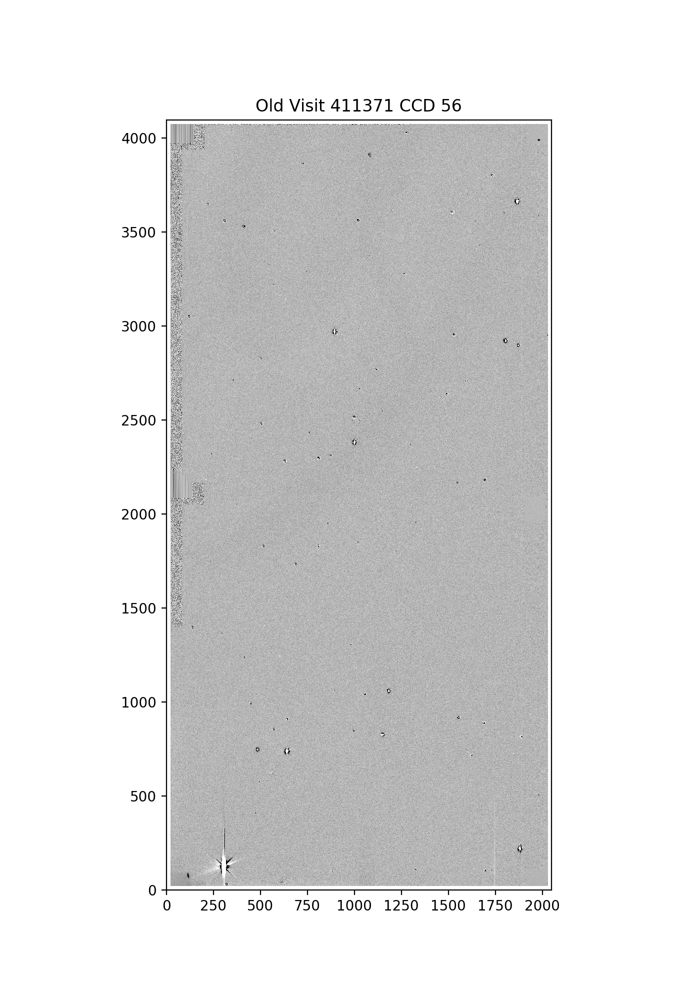

<IPython.core.display.Javascript object>


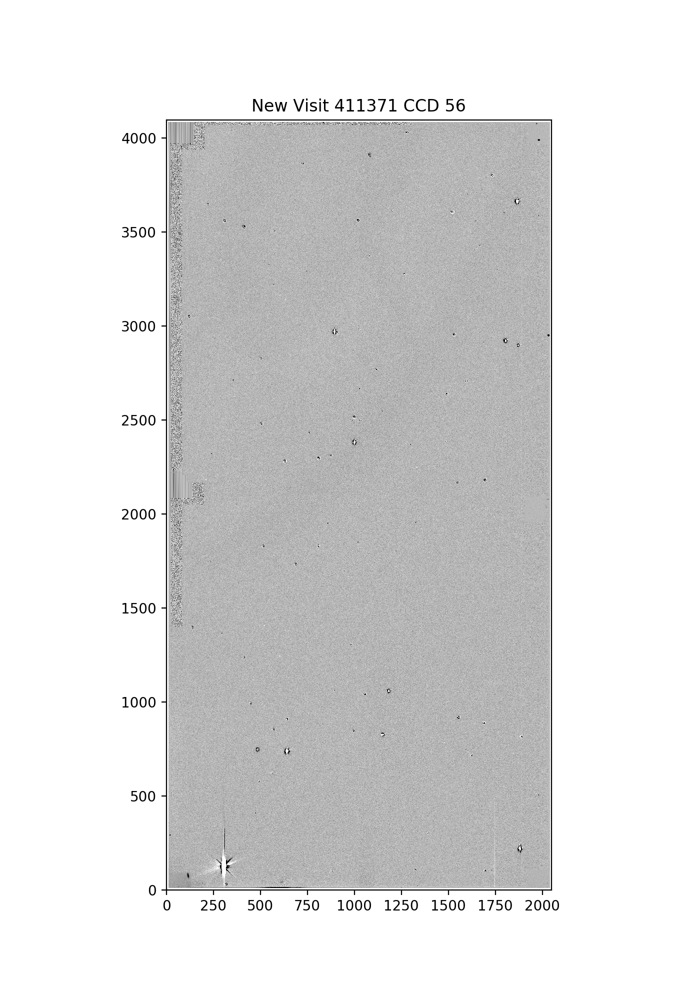

<IPython.core.display.Javascript object>


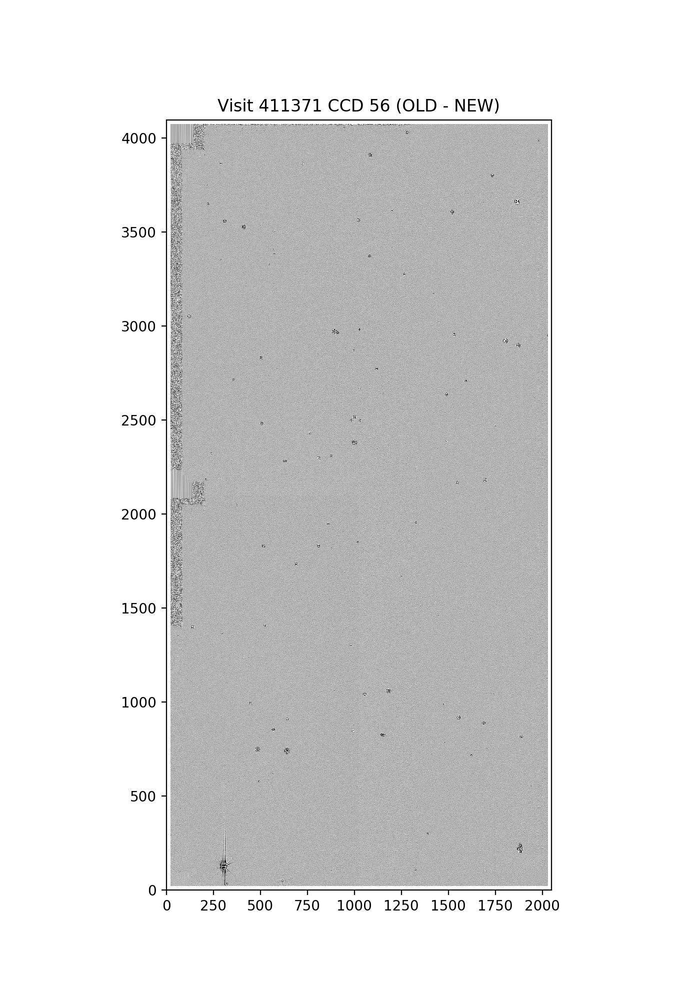

<IPython.core.display.Javascript object>


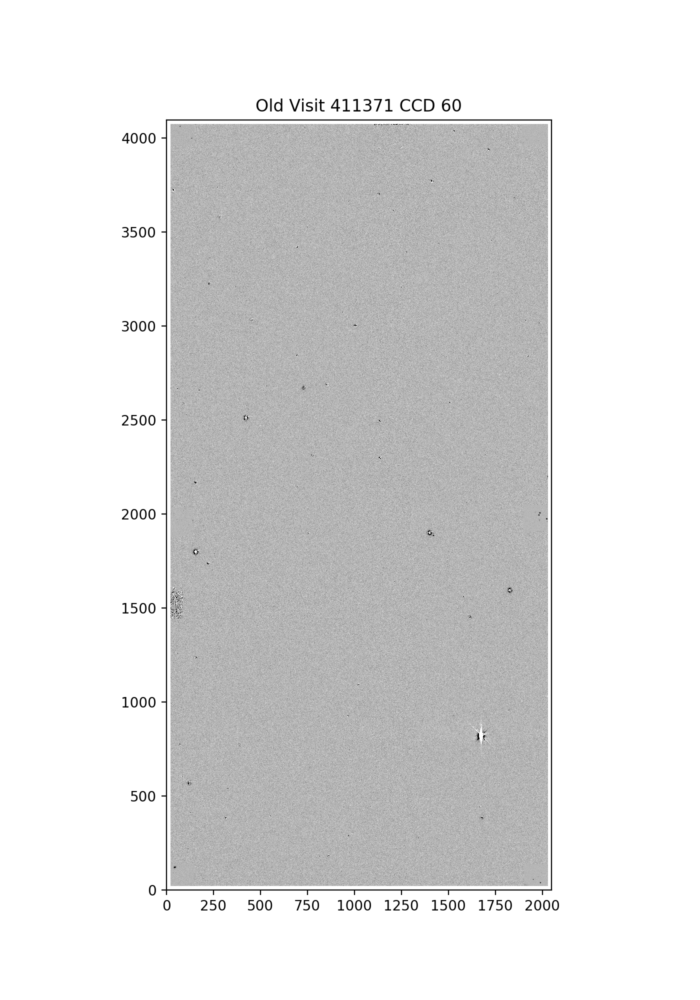

<IPython.core.display.Javascript object>


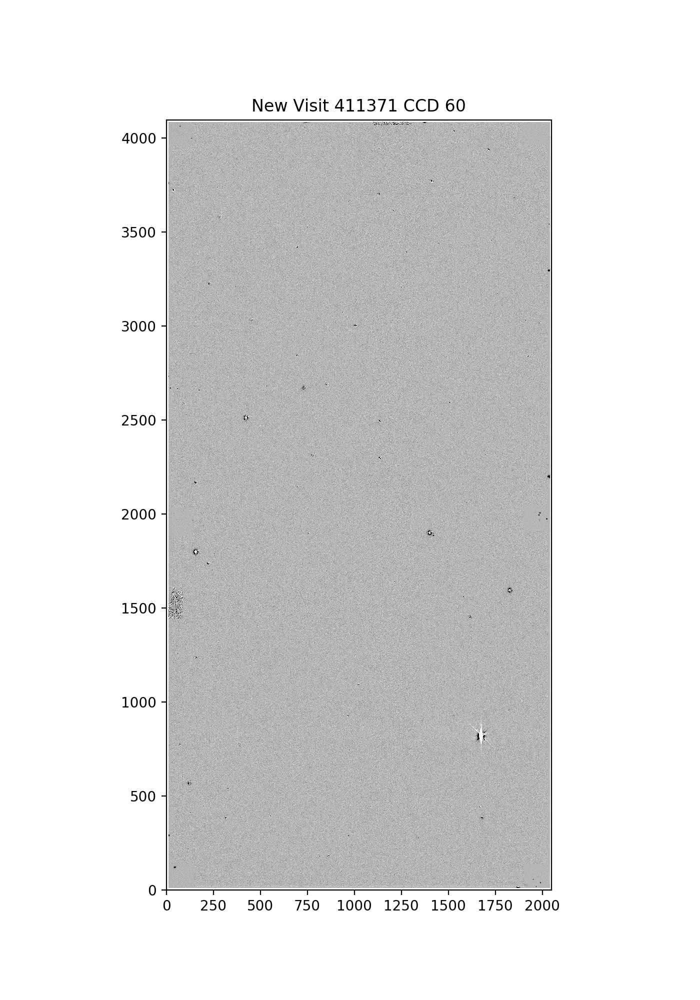

<IPython.core.display.Javascript object>


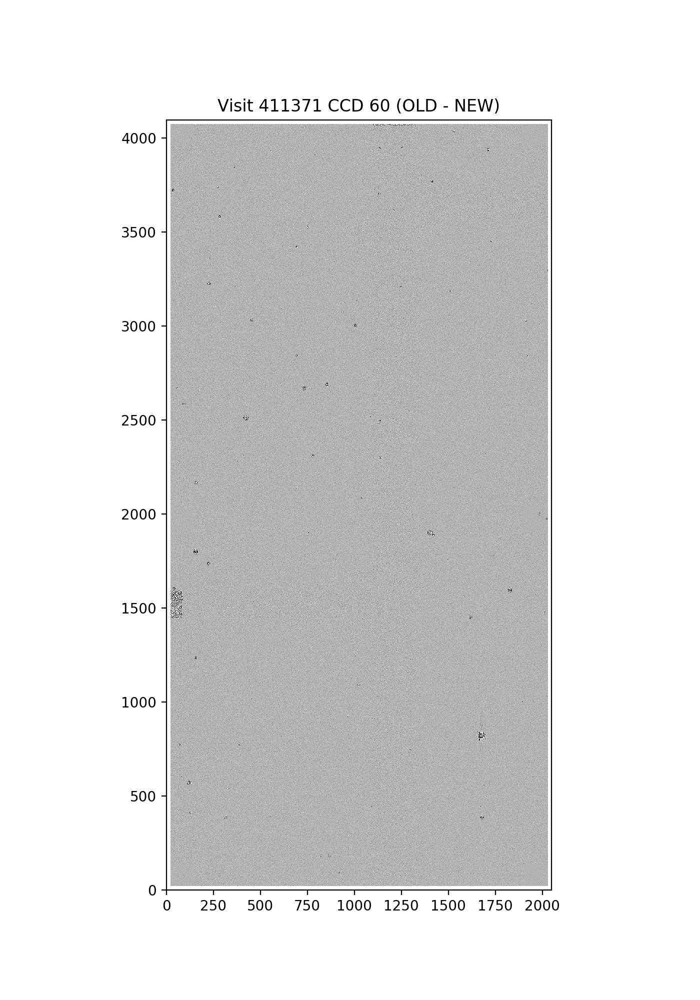

<IPython.core.display.Javascript object>


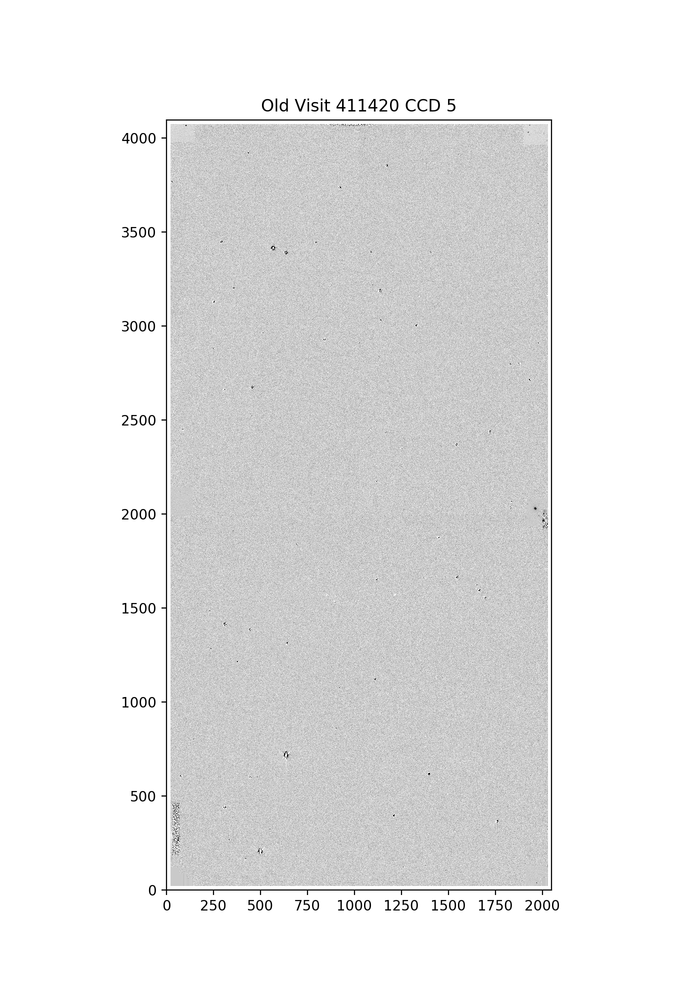

<IPython.core.display.Javascript object>


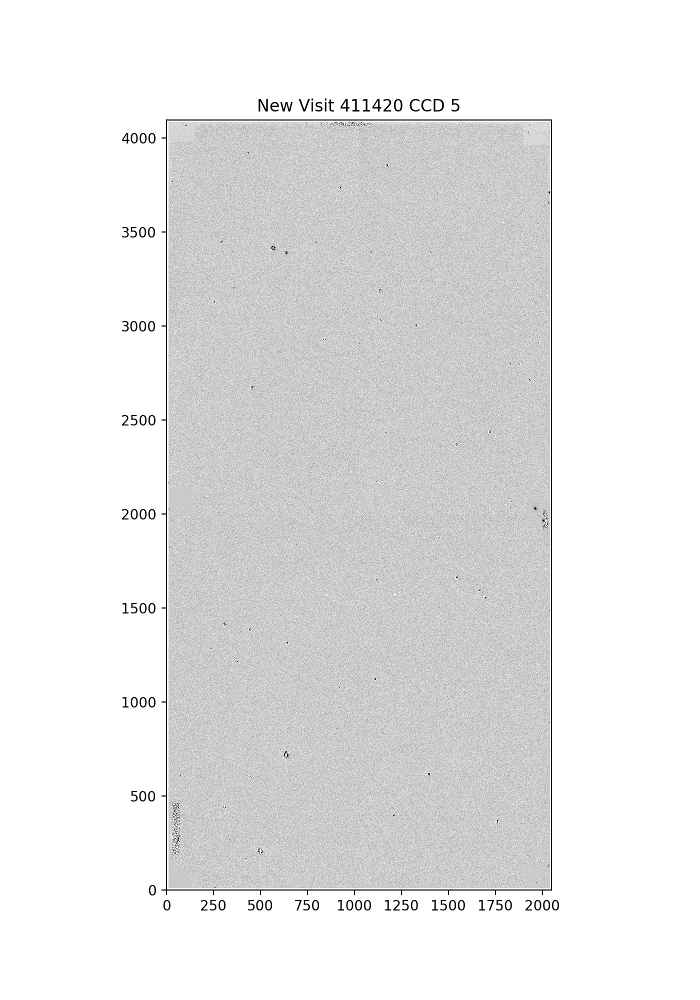

<IPython.core.display.Javascript object>


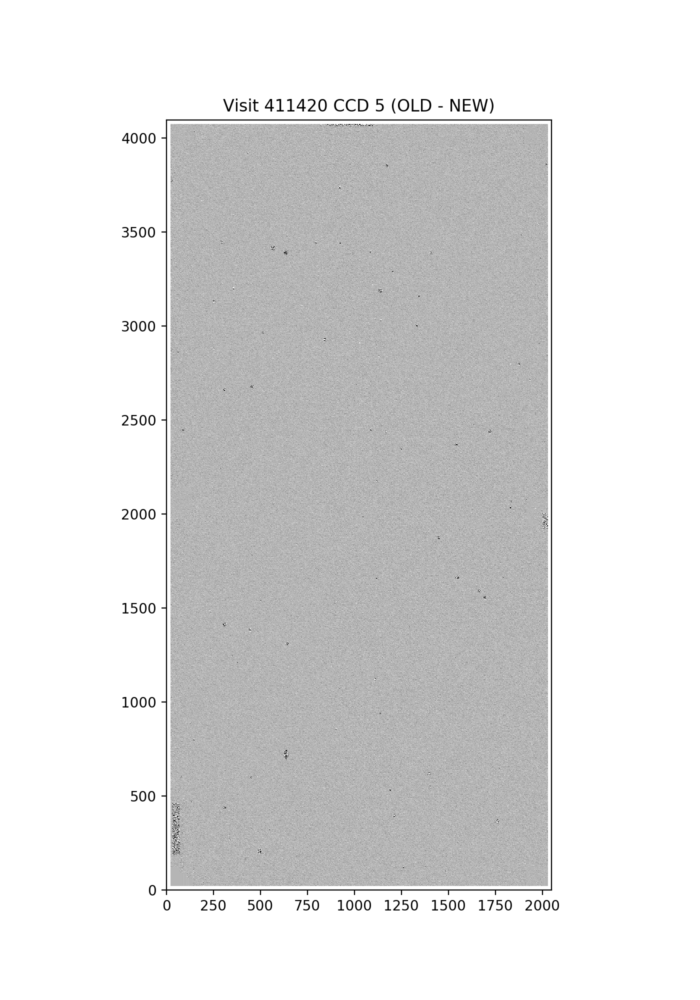

<IPython.core.display.Javascript object>


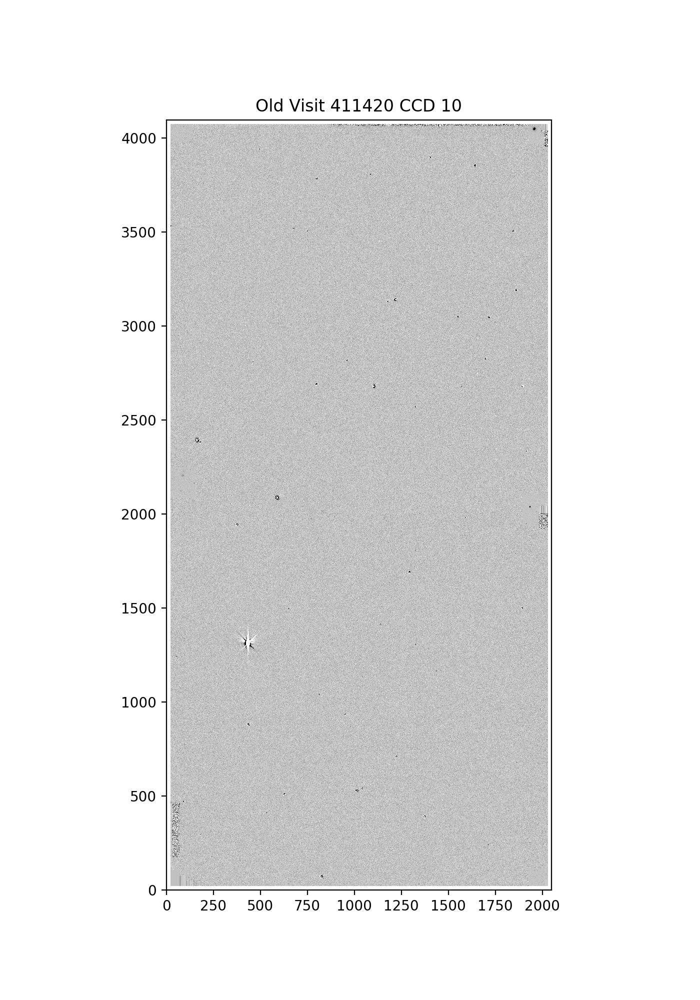

<IPython.core.display.Javascript object>


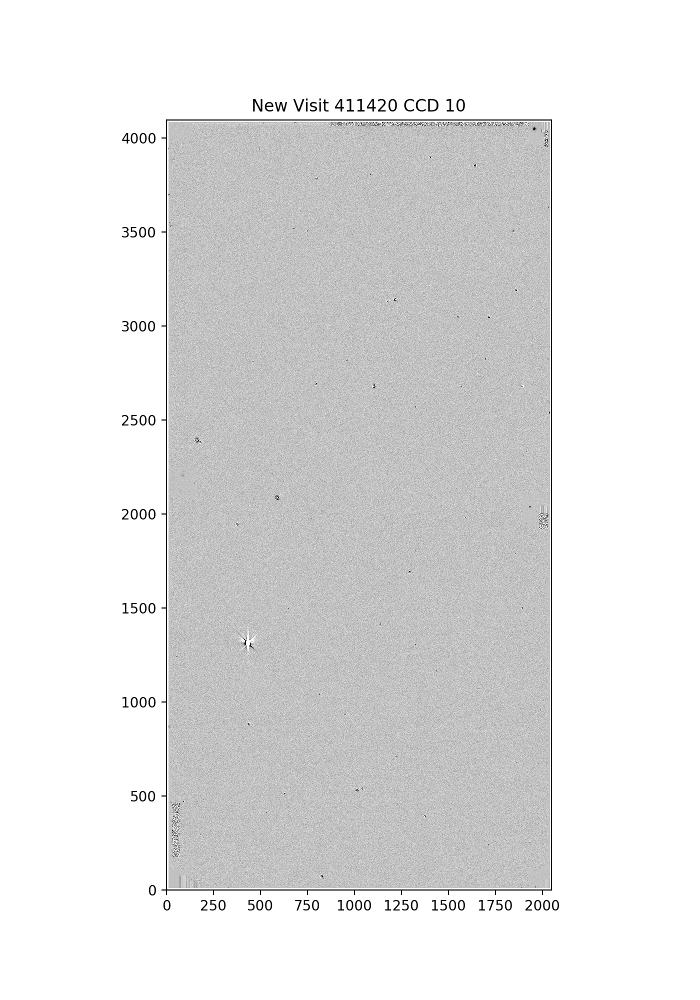

<IPython.core.display.Javascript object>


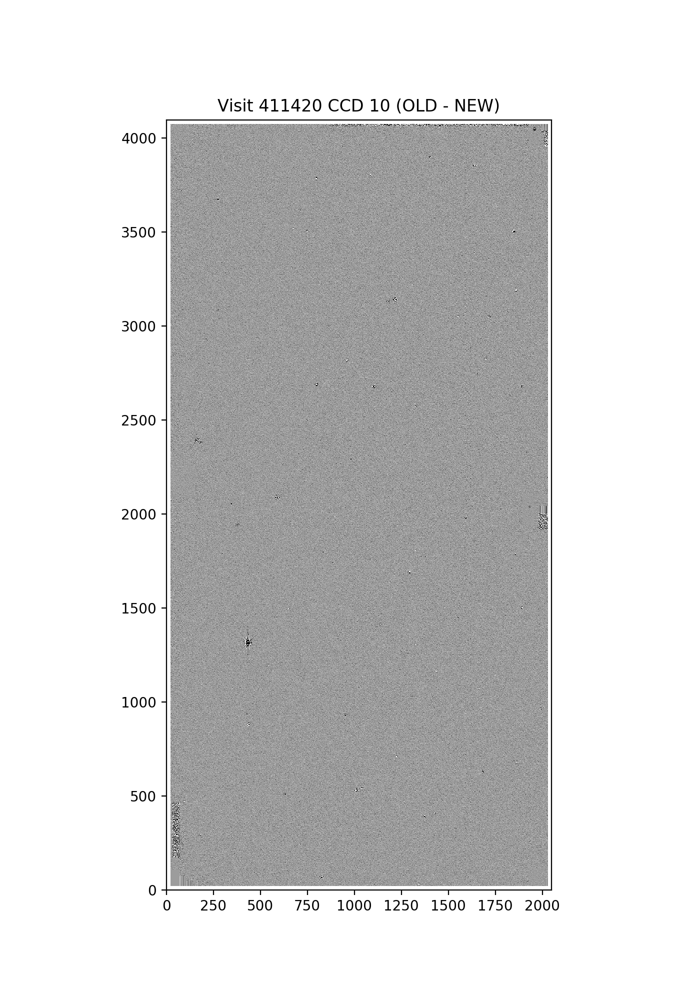

<IPython.core.display.Javascript object>


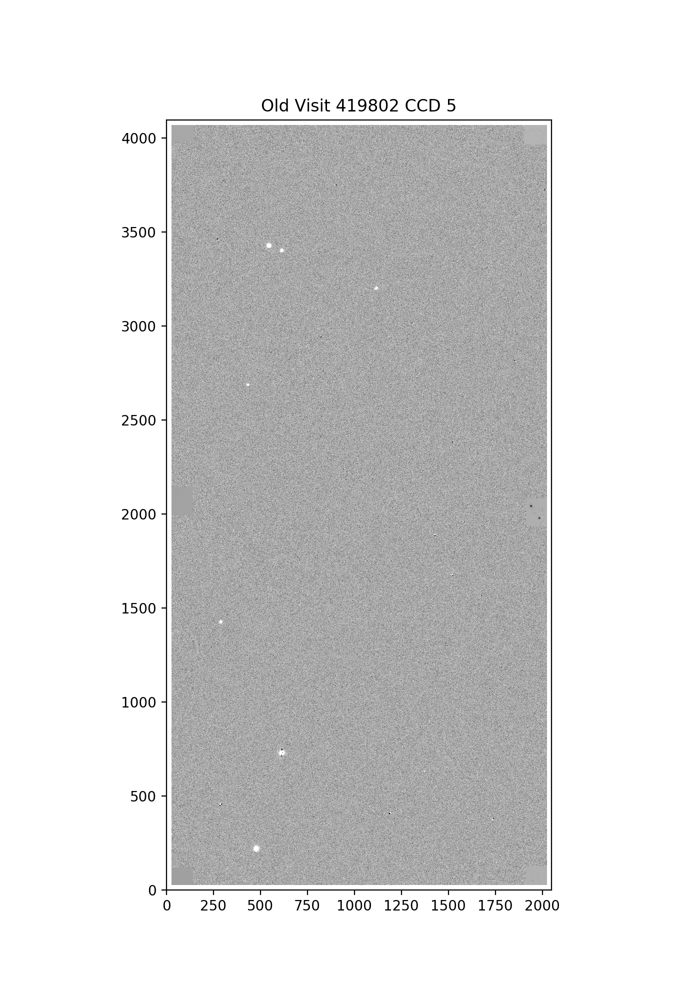

<IPython.core.display.Javascript object>


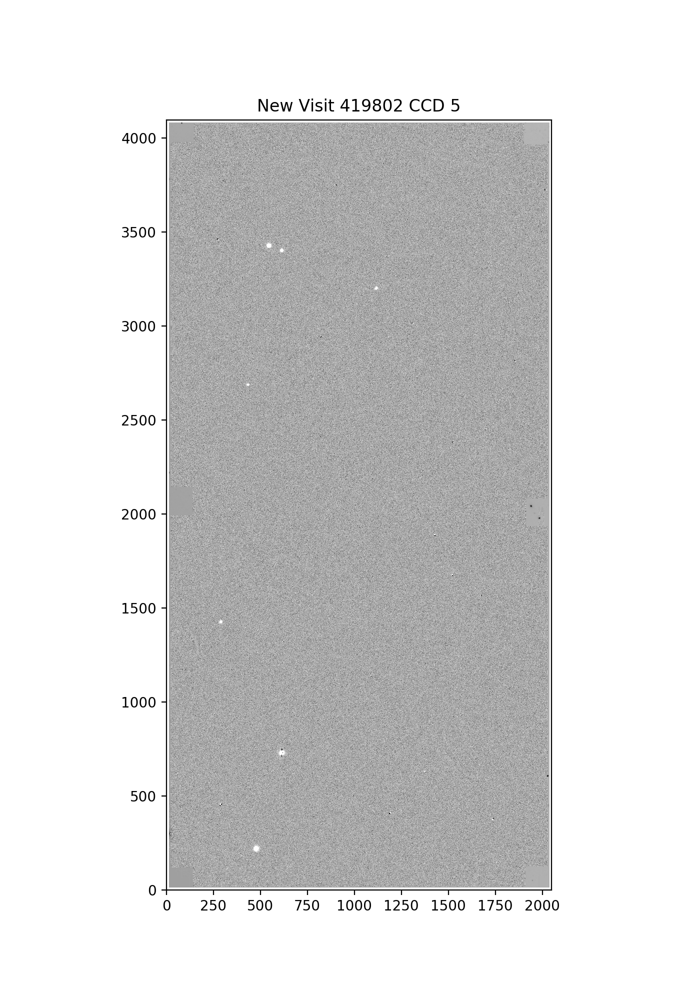

<IPython.core.display.Javascript object>


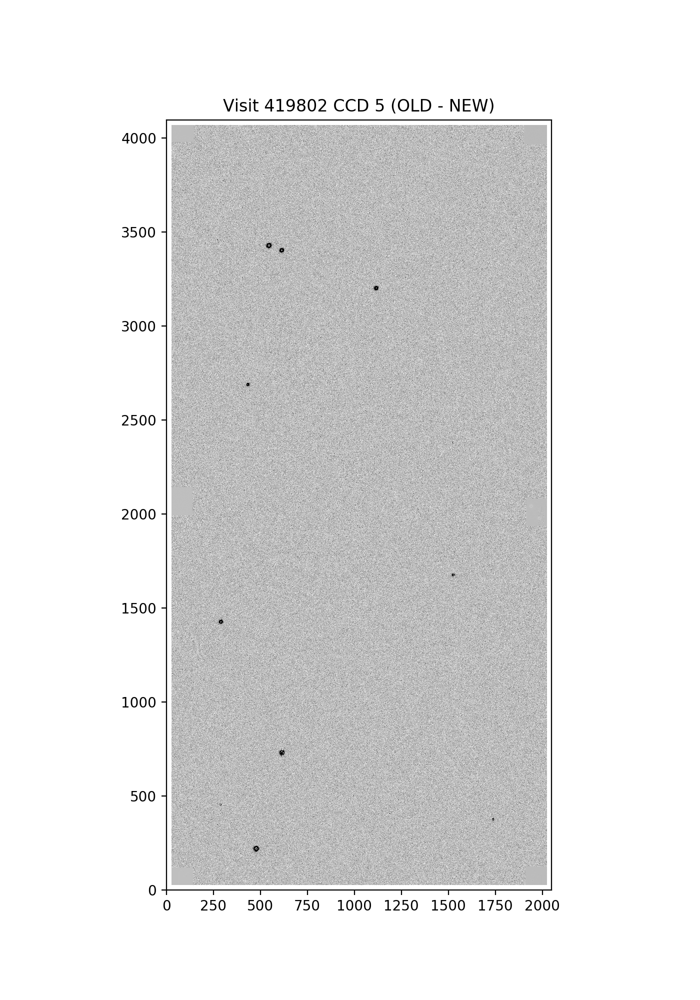

/opt/lsst/software/stack/python/miniconda3-4.7.12/envs/lsst-scipipe-984c9f7/lib/python3.7/site-packages/ipykernel/__main__.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  from ipykernel import kernelapp as app


<IPython.core.display.Javascript object>


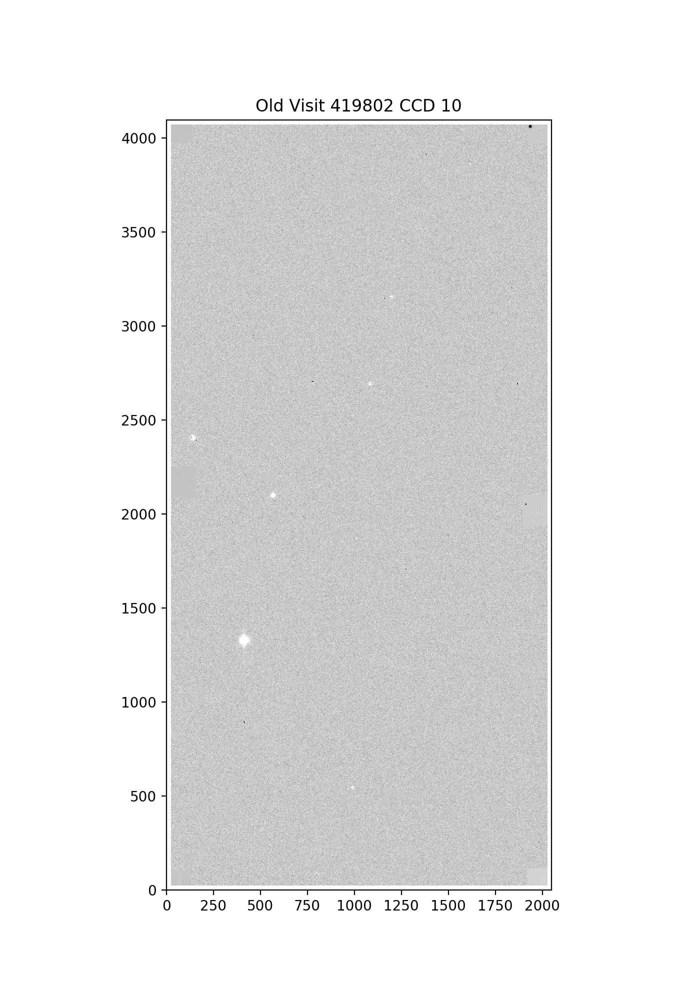

<IPython.core.display.Javascript object>


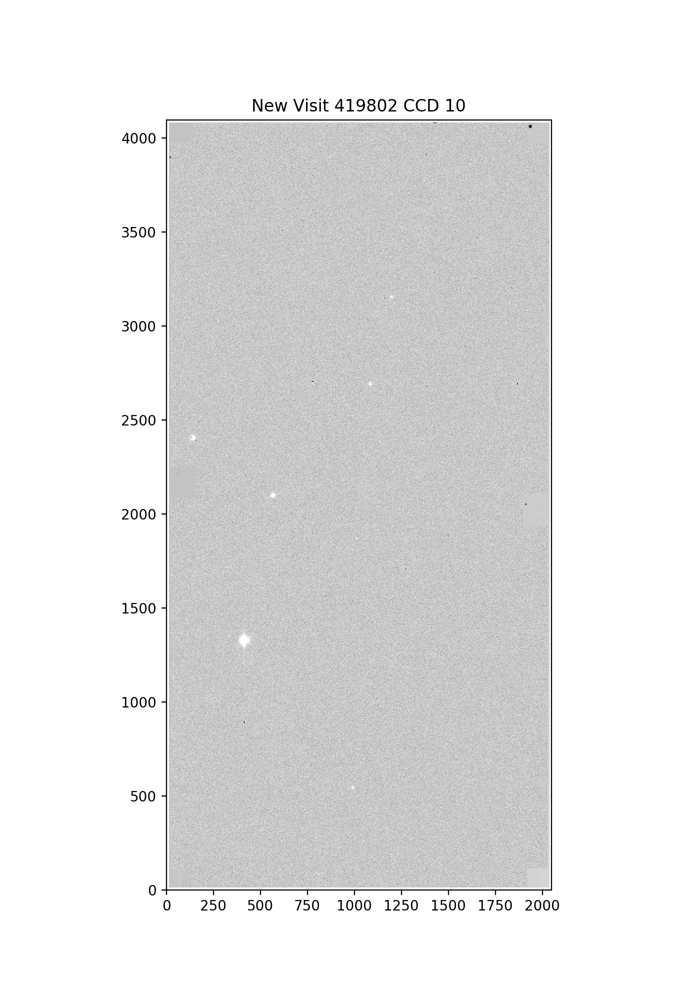

<IPython.core.display.Javascript object>


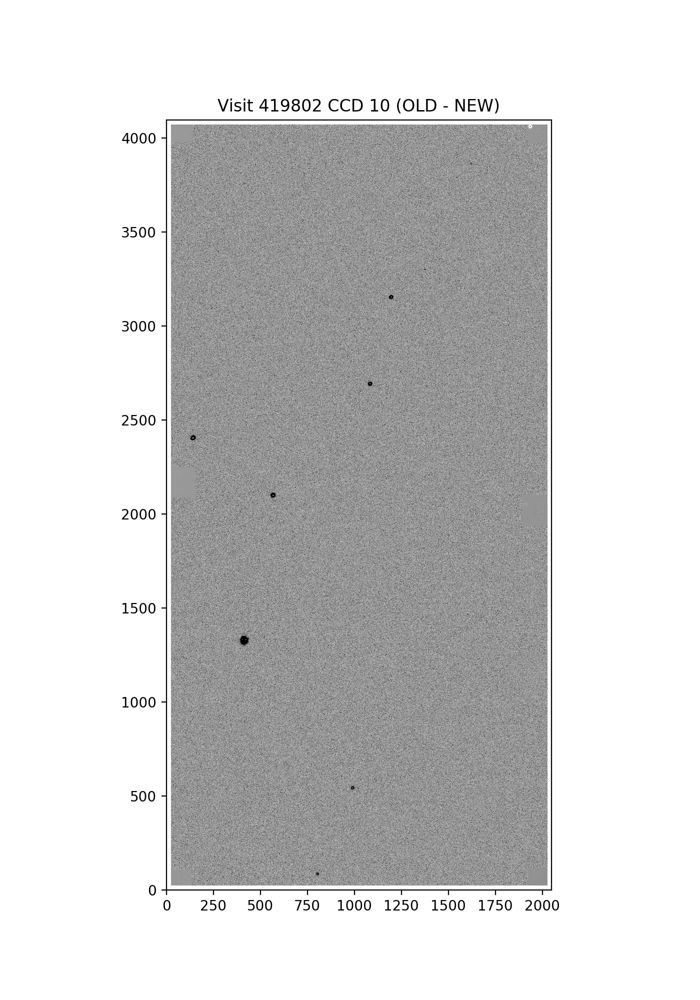

In [31]:
for visit in visits_a:
    for ccd in ccds_a:
        norm = show_image(butler_old, visit=visit, ccd=ccd, title='Old ')
        show_image(butler_new, visit=visit, ccd=ccd, title='New ', norm=norm)
        show_image(butler_old, butler_new, visit=visit, ccd=ccd)
for visit in visits_b:
    for ccd in ccds_b:
        norm = show_image(butler_old, visit=visit, ccd=ccd, title='Old ')
        show_image(butler_new, visit=visit, ccd=ccd, title='New ', norm=norm)
        show_image(butler_old, butler_new, visit=visit, ccd=ccd)

# The images look reasonable

A few things to note:

- The largest differences appear to be the halos of bright sources, which is expected.
- The background subtraction for CCD 56 seems to be different. I don't see how this could be the result of the decorrelation afterburner.
- Noisy pixels at the chip edges are different.
- All of the bright sources appear to be slightly smeared out, with the largest effect in the visit with poor seeing (419802).

## Since the images are reasonable, let's look at the number of DIA sources

In [11]:
objTable_old, srcTable_old, goodObj_old, goodSrc_old = pla.loadTables(old_repo)

In [12]:
objTable_new, srcTable_new, goodObj_new, goodSrc_new = pla.loadTables(new_repo)

<IPython.core.display.Javascript object>


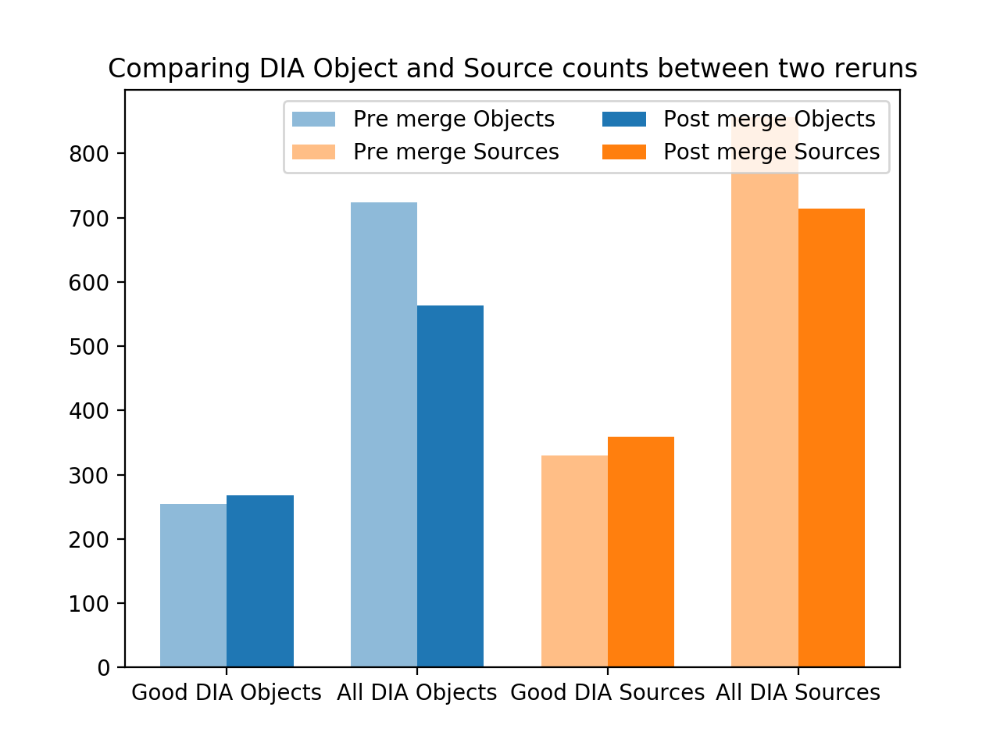

Text(0.5, 1.0, 'Comparing DIA Object and Source counts between two reruns')

In [13]:
srcTable1 = srcTable_old
goodSrc1 = goodSrc_old
objTable1 = objTable_old
goodObj1 = goodObj_old
label1 = "Pre merge"

srcTable2 = srcTable_new
goodSrc2 = goodSrc_new
objTable2 = objTable_new
goodObj2 = goodObj_new
label2 = "Post merge"

fig, ax = plt.subplots()
barLabels = ['Good DIA Objects', 'All DIA Objects', 'Good DIA Sources', 'All DIA Sources']
xbar = np.array([0, 1])
width = 0.35

# February 2020
ax.bar(xbar - width/2, [len(goodObj1), len(objTable1)], 
       width, label=label1 + ' Objects', color='C0', alpha=0.5)
ax.bar(xbar + 2 - width/2, [len(goodSrc1), len(srcTable1)],
       width, label=label1 + ' Sources', color='C1', alpha=0.5)

# April 2020
ax.bar(xbar + width/2, [len(goodObj2), len(objTable2)], 
       width, label=label2 + ' Objects', color='C0')
ax.bar(xbar + 2 + width/2, [len(goodSrc2), len(srcTable2)],
       width, label=label2 + ' Sources', color='C1')

plt.legend(ncol=2)
ax.set_xticks([0, 1, 2, 3])
labels = ax.set_xticklabels(barLabels)
plt.title('Comparing DIA Object and Source counts between two reruns')

## The total number of DIA objects and sources decreased substantially, while the number of 'good' objects and sources increased slightly

In [14]:
def plotHitsSourcesOnSky_mod(sourceTable, title=''):
    """Plot DIA Sources from three DECam HiTS fields on the sky.

    Can also be used to plot DIA Objects instead of DIA Sources.
    
    Modified for this notebook to only plot the one HiTS field with test data.

    Parameters
    ----------
    sourceTable : `pandas.core.frame.DataFrame`
        Pandas dataframe with DIA Sources from an APDB.
    title : `str`
        Title for the plot, optional.
    """
    fig, ax = plt.subplots()

    ax.scatter(sourceTable['ra'],
                sourceTable['decl'],
                c='C0', s=2, alpha=0.2)
    ax.invert_xaxis()

    ax.set_xlabel('RA (deg)')
    ax.set_ylabel('Dec (deg)')

    plt.title(title)

## Let's look at just the DIA objects

<IPython.core.display.Javascript object>


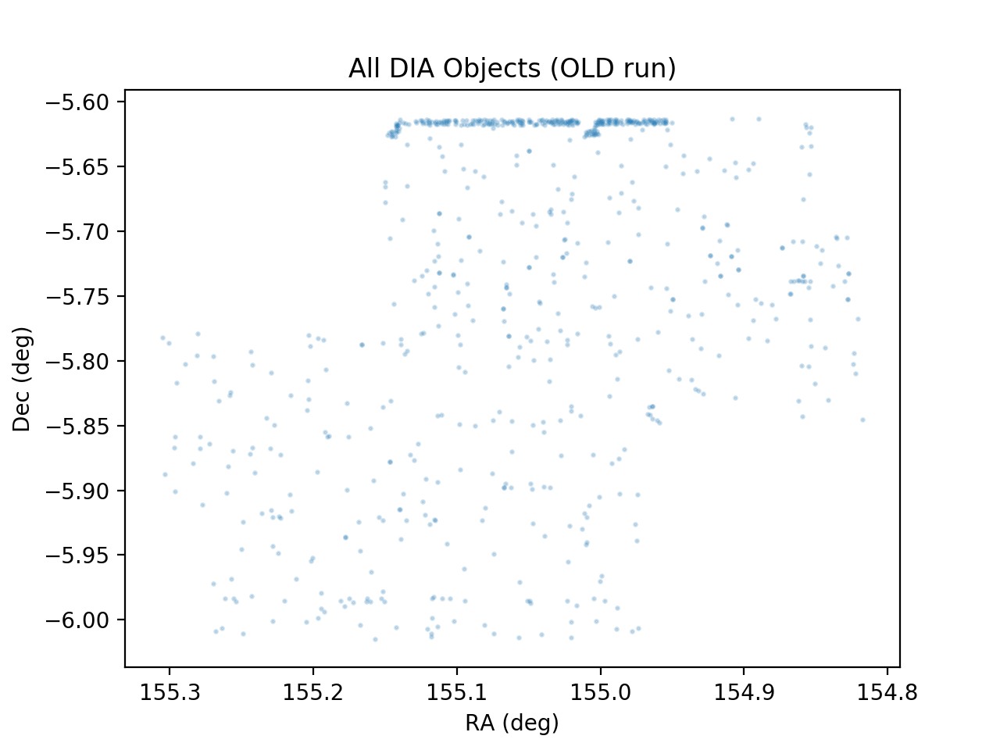

In [15]:
hitsPlot_old = plotHitsSourcesOnSky_mod(objTable_old, title='All DIA Objects (OLD run)')

/opt/lsst/software/stack/python/miniconda3-4.7.12/envs/lsst-scipipe-984c9f7/lib/python3.7/site-packages/ipykernel/__main__.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


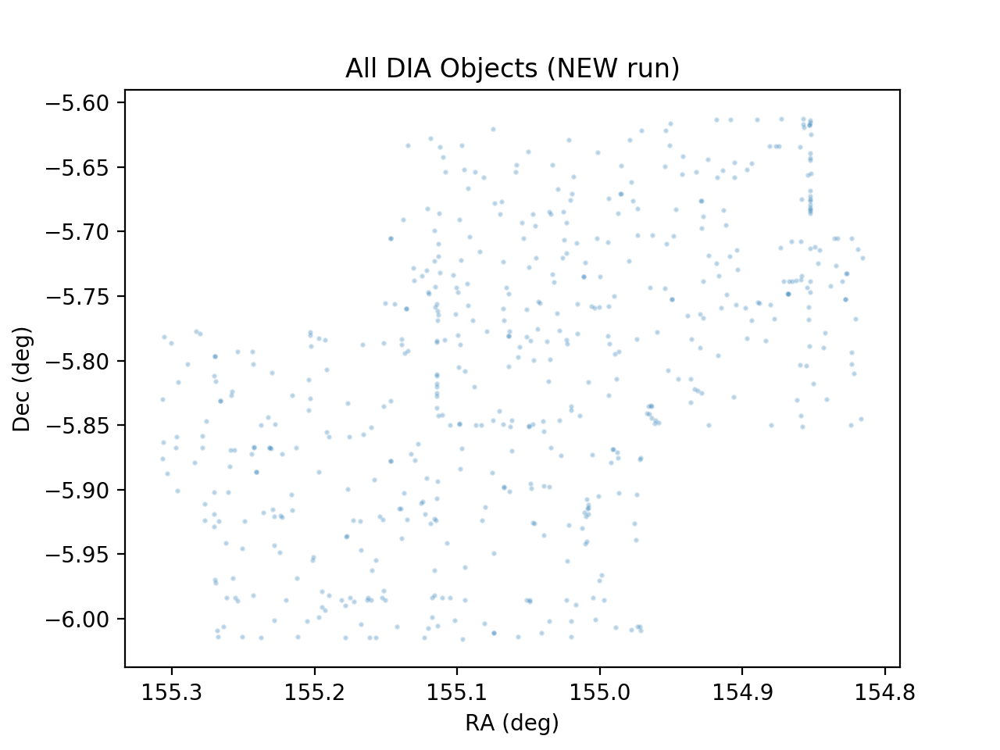

In [17]:
hitsPlot_old = plotHitsSourcesOnSky_mod(objTable_new, title='All DIA Objects (NEW run)')

/opt/lsst/software/stack/python/miniconda3-4.7.12/envs/lsst-scipipe-984c9f7/lib/python3.7/site-packages/ipykernel/__main__.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


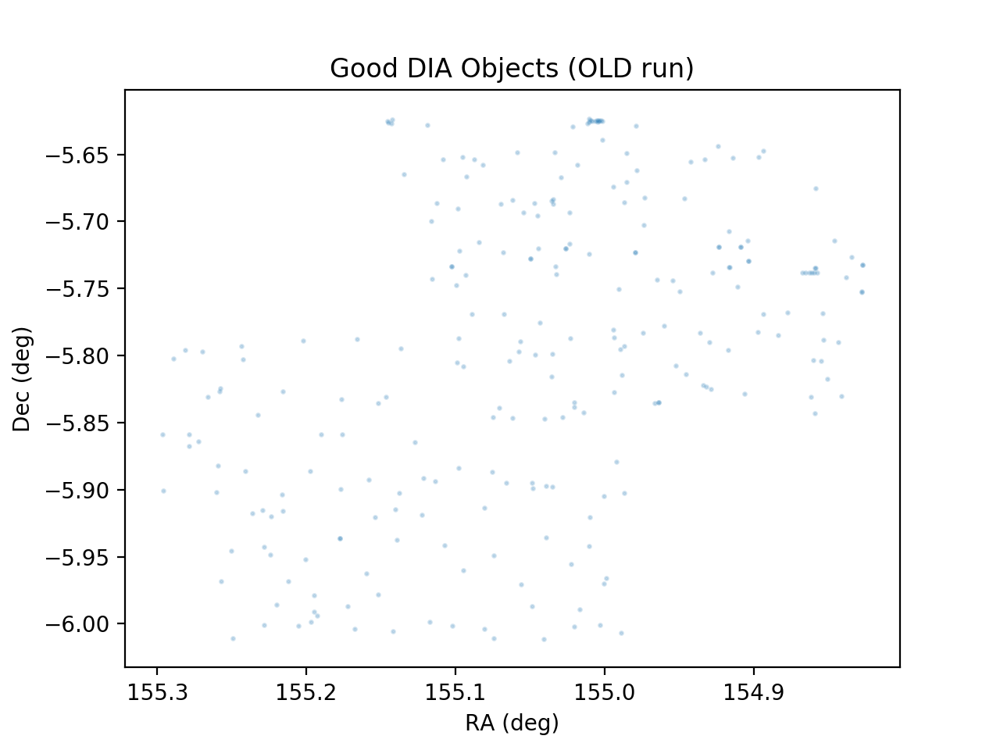

In [18]:
hitsPlot_old = plotHitsSourcesOnSky_mod(goodObj_old, title='Good DIA Objects (OLD run)')

/opt/lsst/software/stack/python/miniconda3-4.7.12/envs/lsst-scipipe-984c9f7/lib/python3.7/site-packages/ipykernel/__main__.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


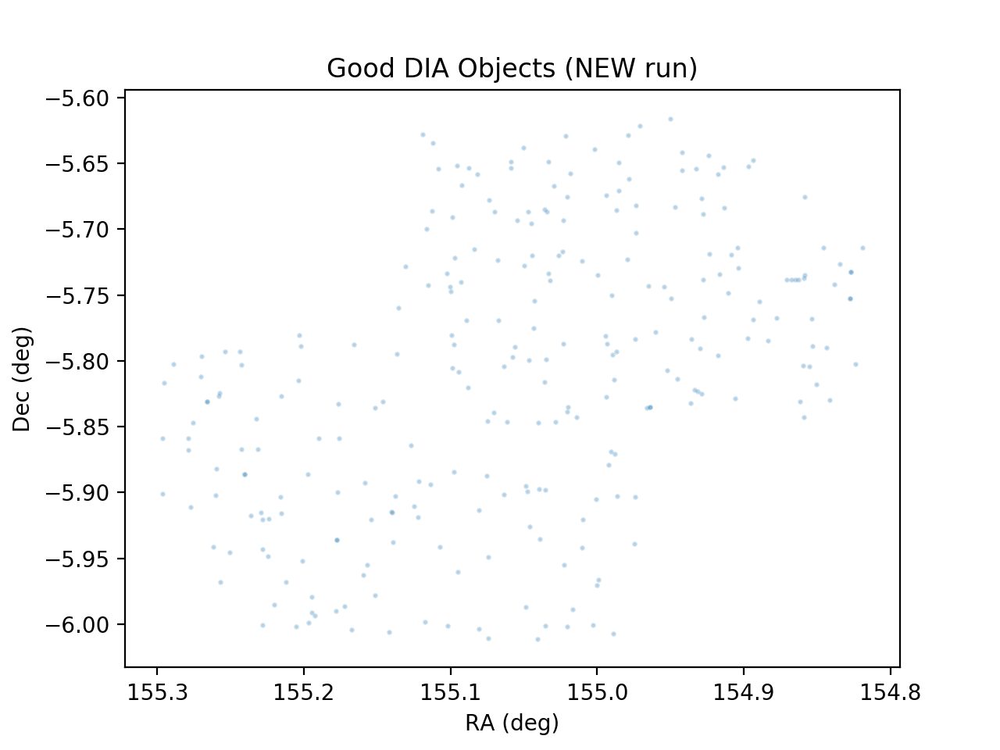

In [19]:
hitsPlot_new = plotHitsSourcesOnSky_mod(goodObj_new, title='Good DIA Objects (NEW run)')

## The biggest difference is that *many* bad sources along one CCD edge (#56) are no longer detected, though you can see some new bad sources along other CCD edges.
The "good" DIA objects look quite reasonable both with the old code and the new, though I might be able to see a slight excess of sources along the bad edge of CCD 56 with the old code.
Since the number of total DIA objects decreased and the number of "good" objects increased slightly, it makes sense that the fraction of "good" DIA objects would increase substantially, as we saw on Chronograph at the meeting.

# Conclusion
The changes we saw on Chronograph look reasonable, and are probably a positive result of merging the decorrelation afterburner code.